# Rodrigo de Souza Gonçalves (RA:0038236)
# Israel Monteiro Dias (RA:0039011)

# **Tema : Analise de Sinais para Detecção de Falhas**

  A manutenção de qualquer que seja o equipamento requer sempre aperfeiçoamento, com objetivo de evitar problemas.

Sabemos que, quando equipamento para, este compromete o processo produtivo daquela planta industrial.

Tempo de parada significa prejuízo, um fator causado por qualquer que seja o processo produtivo.

Geralmente os primeiros sinais de falha se dão pela mudança do padrão de vibração, ruido, temperatura e são seguidos por uma perda de desempenho.
  
  **OBJETIVO:**

Como objeto de estudo foi utilizando um equipamento muito importante nos grandes hospitais, Esterilizador por Vapor (autoclave).

O objetivo deste equipamento é esterilizar todo o material utilizado em procedimentos médicos, abrange desde materiais avançados de alta complexidade até procedimentos menos invasivos.

Durante seu funcionamento é necessário o uso de uma bomba de vácuo, e esta utiliza água para que seja criada as partículas dentro da câmara interna da autoclave.

Se em um dado momento falta água o ruído provocado pela bomba de vácuo e notoriamente diferente.

Um equipamento como este pode apresentar diferentes tipos de defeitos, porem iremos nos concentrar na bomba de limpeza deste equipamento.

Utilizamos um celular para gravar o ruído gerado pela bomba de vácuo quando essa, esta em falha e quando está funcionando normalmente. Objetivo é evidenciar a falha a partir da análise no domínio da frequência.

Para tal análise, utilizamos tecnicas de Processamento de Sinais como ferramenta, sendo uma delas a transformada de Fourier associado com a programação do algoritmo em python.


**Autoclave BAUMER**

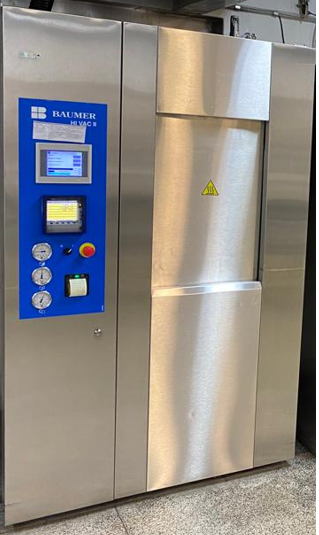


**EQUIPAMENTO:**
- Esterilizador por Vapor (Linha Hi Vac II)
- Modelo : B0110-370  

**CAPACIDADE:**
- 370 Litros

**DADOS COLETADOS:**
- RUIDO EMITIDO PELA BOMBA DE VACUO 



**BOMBA DE VÁCUO**


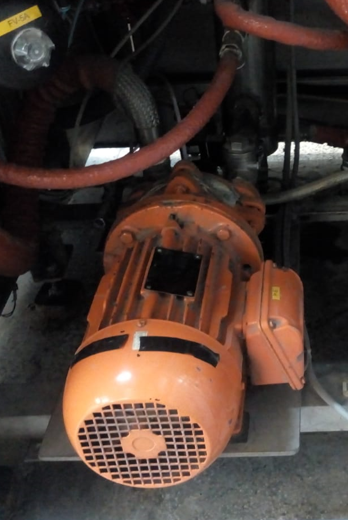 

In [1]:
## importando biblioteca##
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa.display
import librosa 
import scipy as sp
import requests
from scipy import signal
from scipy.fft import fftshift,fft, ifft
from scipy.io import wavfile

**IMPORTA GRAVAÇÃO**

O objetivo do código abaixo é importa a gravação do ruído emitido pela bomba de vácuo em funcionamento.

In [2]:
# AUDIO BOMBA COM FALHA
response = requests.get('https://github.com/rodrigosg000/audio_bomba_falha/blob/46f36030e715e2633b87894bda3bdc692378b530/audio_bomba_defeito.wav?raw=true')
open("audio_bomba_defeito.wav", "wb").write(response.content)
fs,audio_bomba = wavfile.read('audio_bomba_defeito.wav')

In [3]:
# AUDIO BOMBA SEM FALHA
response = requests.get('https://github.com/rodrigosg000/audio_bomba_falha/blob/c68253ac15871828e8dafe9a802bc562c380c976/audio_bomba_normal.wav?raw=true')
open("audio_bomba_normal.wav", "wb").write(response.content)
fs,audio_bomba_normal = wavfile.read('audio_bomba_normal.wav')


**ipd.Audio**

Por meio deste condigo, é possível a executar o ruído emitido pela bomba de vácuo.

In [4]:
# AUDIO COM FALHA 
ipd.Audio(audio_bomba, rate=fs, normalize=True)

In [5]:
# AUDIO SEM FALHA 
ipd.Audio(audio_bomba_normal, rate=fs, normalize=True)

**Plot do ruido no dominio do tempo**


Temos abaixo o gráfico do ruído emitido pela bomba de vácuo no domínio do tempo.

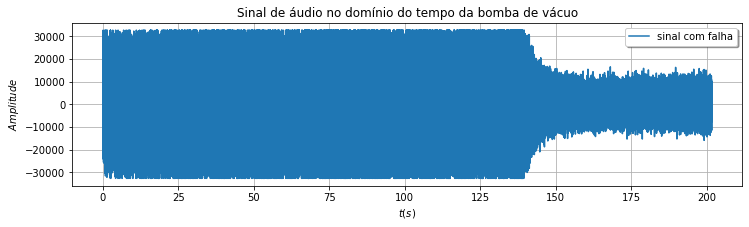

In [6]:
#Plot do sinal no dominio do tempo com falha

#%matplotlib widget
%matplotlib inline

tempo = np.arange(len(audio_bomba))/fs # variável TEMPO (em segundos)
plt.figure(figsize=(12,3))
plt.plot(tempo, audio_bomba ,label='sinal com falha')
plt.title('Sinal de áudio no domínio do tempo da bomba de vácuo')
plt.xlabel("$t(s)$")
plt.ylabel("$Amplitude$")
plt.legend(loc='best', shadow=True, framealpha=1)
plt.grid(1);

Por inspeção no gráfico acima,  podemos afirmar que a bomba de vácuo trabalho em falha do instante inicial 0s até aproximadamente 139s. Observamos que durante este período a amplitude do sinal tem maior intensidade, do que no momento que a bomba está operando normalmente. A partir de 150s até o instante final a bomba voltou a operar normalmente.

**ESPECTROGRAMA**

Abaixo temos o espectrograma do sinal e a FFT .

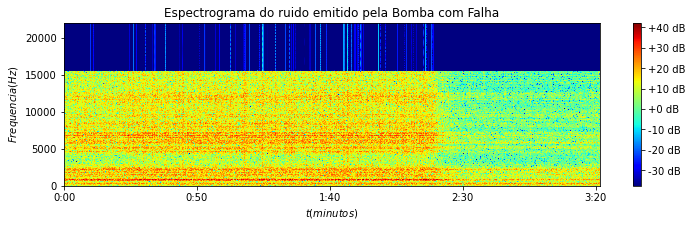

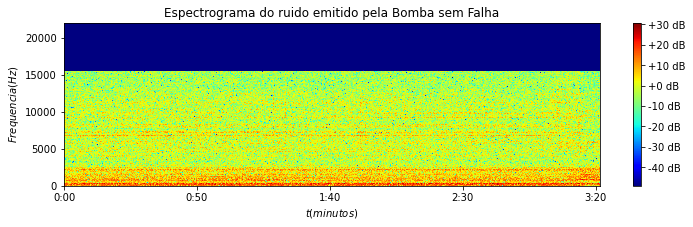

In [7]:
# Este codigo fara o plot do espectrogrma do sinal coletado 
#%matplotlib inline

x ,  sr  =  librosa.load ( 'audio_bomba_defeito.wav', sr = 44100,duration=None )
x1 ,  sr  =  librosa.load ( 'audio_bomba_normal.wav', sr = 44100,duration=None )

plt.figure(figsize=(12,3))
Xdb = librosa.amplitude_to_db(np.abs(librosa.stft(x, window='hann', pad_mode='edge')))
librosa.display.specshow(Xdb, y_axis='linear', sr=sr,x_axis='time',cmap = 'jet')
plt.colorbar(format='%+2.0f dB')
plt.xlabel("$t  (minutos)$")
plt.ylabel("$Frequencia  (Hz)$")
plt.title("Espectrograma do ruido emitido pela Bomba com Falha");

plt.figure(figsize=(12,3))
Xdb = librosa.amplitude_to_db(np.abs(librosa.stft(x1, window='hann', pad_mode='edge')))
librosa.display.specshow(Xdb, y_axis='linear', sr=sr,x_axis='time',cmap = 'jet')
plt.colorbar(format='%+2.0f dB')
plt.xlabel("$t  (minutos)$")
plt.ylabel("$Frequencia  (Hz)$")
plt.title("Espectrograma do ruido emitido pela Bomba sem Falha");

Por inspeção no gráfico concluímos que o espectro de maior frequência ocorre entre 4500Hz e 15500HZ. 

Podemos afirma que a faixa de operação normal da bomba de vácuo ocorre 0 Hz até 2500Hz, pois quando olhamos para o tempo superior a 2:30 minutos notamos que esta faixa de frequência se mantêm constante. 

Note que a energia onde ocorre a falha e bem superior em intensidade, quando comparamos o sinal da bomba em funcionamento normal.


**TRANSFORMADA DE FOURIER (FFT)**

O objetivo da FFT é evidenciar tudo que foi analisado a partir do espectrograma

In [8]:
# Função Transformada de Fourier

def fourier(x, t, Hz=False, dB=False, deg=False, Nfft=None): 
    
        N = x.size
        T = t[1]-t[0]
        ######################################
        if Nfft is None: 
            Nfft = x.size
        ######################################
        X_f = fft(x, n=Nfft);
        X_f = X_f/N # corrige amplitude do sinal
        X_f = X_f[:Nfft//2] # suprime os espelhamentos do sinal na freq
        X_f[1:] = 2*X_f[1:] # dobra a amplitude das freqs diferente de zero

        
        ################################

        if Hz is True:
            f0 = 1/(Nfft*T) #freq em Hz
            fHz = np.arange(Nfft)*f0 #freq em Hz
            fHz = fHz[:Nfft//2]
            f=fHz

        elif Hz is False:
            w0 = 2*np.pi/(Nfft*T) #freq em rad/s
            wRad = np.arange(Nfft)*w0 #freq em rad/s
            wRad = wRad[:Nfft//2]
            f=wRad

        ###############################################    
        if dB is True:
            mag = 20*np.log10(np.abs(X_f)) # modulo no dominio da frequencia em dB

        elif dB is False:
            mag = np.abs(X_f) # modulo no dominio da frequencia

        ################################################### 

        if deg is True:
            fase = np.angle(X_f, deg) # fase no dominio da frequencia
            pha = fase
        elif deg is False:
            fase = np.angle(X_f, deg) # fase no dominio da frequencia
            pha = fase
        #####################################################  


        return (mag, pha, f)

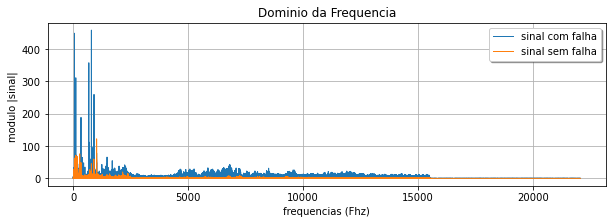

In [17]:
#%matplotlib widget

mag1, pha1, f1 = fourier(audio_bomba, tempo, Hz=True, dB=False, deg=False, Nfft=None)#fft sinal
mag2, pha2, f2 = fourier(audio_bomba_normal, tempo, Hz=True, dB=False, deg=False, Nfft=None)#fft sinal


#Graficos fft sinal


plt.figure(figsize=(10,3))
plt.plot(f1, mag1, linewidth=1.0, label='sinal com falha')
plt.plot(f2, mag2, linewidth=1.0, label='sinal sem falha')
plt.legend(loc='best', shadow=True, framealpha=1)
plt.title("Dominio da Frequencia");
plt.xlabel("frequencias (Fhz)")
plt.ylabel("modulo |sinal| ")
plt.grid(1);

Com auxílio da FFT podemos afirmar, que existe conteúdo espectral que merece nossa atenção a partir de 4500Hz. Será necessário elaborar um projeto de um filtro passa faixa. Pois iremos nos concentrar somente nas frequências superiores a 4500Hz.

**PROJETO FILTRO PASSA FAIXA**

In [10]:

##### Especificações do filtro ######

Ap = 0.05 # Atenuação na banda de passagem
Ar = 60  # Atenuação na banda de rejeição

# FREQUÊNCIA DE CORTE EM Hz

fp1 = 4500  # frequencia banda de passagem 
fp2 = 15500  # frequencia banda de passagem 
fr1 = 4490  # frequencia banda de rejeição
fr2 = 15510  # frequencia banda de rejeição
fs  = 44100 # frequencia amostragem

# FREQUÊNCIA DE CORTE EM rad/s

ws =  2*np.pi*fs  # frequencia de amostragem 
wp1 = 2*np.pi*fp1 # frequencia banda de passagem 
wp2 = 2*np.pi*fp2 # frequencia banda de passagem 
wr1 = 2*np.pi*fr1 # frequencia banda de rejeiçao
wr2 = 2*np.pi*fr2 # frequencia banda de rejeiçao


### FIM DO CÓDIGO ###

In [11]:
# Calculo da ordem do filtro 

ord_iir, wn_iirr = signal.ellipord(wp2, wr2, Ap, Ar, analog=False,fs=ws)


print('A ordem do filtro IIR :' ,ord_iir)


A ordem do filtro IIR : 18


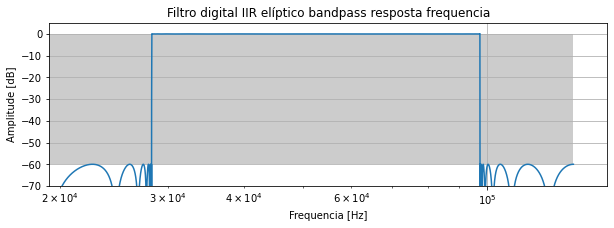

In [12]:
%matplotlib inline
#%matplotlib widget

sos = signal.iirfilter(ord_iir, [fp1, fp2] ,rp = Ap, rs = Ar, btype='band',analog=False, ftype='ellip', fs=44100,output='sos');



w, h = signal.sosfreqz(sos,worN=10**6, fs=ws);
fig = plt.figure(figsize=(10,3));
ax = fig.add_subplot(1, 1, 1);
ax.semilogx(w, 20 * np.log10(np.maximum(abs(h), 1e-8)));
ax.set_title('Filtro digital IIR elíptico bandpass resposta frequencia');
ax.set_xlabel('Frequencia [Hz]');
ax.set_ylabel('Amplitude [dB]');
ax.grid();

#Gabarito do filtro #

plt.fill([wp1, wp2,  wp2,  wp1], [-Ar, -Ar, -Ap, -Ap], '0.8', lw=1) #  passagem
plt.fill([min(w), wr1, wr1,  min(w)], [-Ar, -Ar, -Ap, -Ap], '0.8', lw=0) #rejeição 1
plt.fill([max(w), wr2,  wr2,  max(w)], [-Ar, -Ar, -Ap, -Ap], '0.8', lw=1) # rejeição 2
plt.axis([wr1-9000, wr2+60000,-Ar-10,Ap+5]);


**FILTRO DIGITAL IIR elíptico**

Foi especificado acima todos os parâmetros necessários para construção do filtro digital IIR elíptico ,e este foi o que apresentou melhor desempenho durante todos os testes para este projeto em específico.


**SINAL FILTRADO**

No código abaixo vamos gerar um novo sinal, apos o sinal original ter passado pelo filtro que foi projetado. 

Com esse novo sinal em mãos, vamos novamente fazer a FFT do sinal filtrado.

In [13]:
## Passando sinal pelo filtro elíptico

sinal_bomba = signal.sosfilt(sos,audio_bomba)
sinal_bomba_normal = signal.sosfilt(sos,audio_bomba_normal)


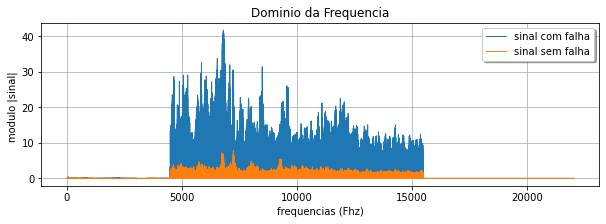

In [14]:
%matplotlib inline
#%matplotlib widget

mag1, pha1, f1 = fourier(sinal_bomba, tempo, Hz=True, dB=False, deg=False, Nfft=None)#fft sinal
mag2, pha2, f2 = fourier(sinal_bomba_normal, tempo, Hz=True, dB=False, deg=False, Nfft=None)#fft sinal

# GRAFICO DA FFT


plt.figure(figsize=(10,3))
plt.plot(f1, mag1, linewidth=1.0, label='sinal com falha')
plt.plot(f2, mag2, linewidth=1.0, label='sinal sem falha')
plt.legend(loc='best', shadow=True, framealpha=1)
plt.title("Dominio da Frequencia");
plt.xlabel("frequencias (Fhz)")
plt.ylabel("modulo |sinal| ")
plt.grid(1);



**ANÁLISE DA FFT DO SINAL FILTRADO**

Por inspeção no gráfico da FFT notamos que o filtro digital IIR elíptico, funcionou de forma adequada. As frequências de análises estão presentes no gráfico. Note que o sinal gerado da bomba de vácuo em falha e semelhante ao sinal da bomba de vácuo operando normal sem falha. 

Portanto, concluímos que somente filtrar o sinal e fazer a FFT não é o suficiente para evidenciar a falha. Por isso passaremos para próxima etapa, que consiste em calcular a energia de um sinal finito.


**CALCULO DA ENERGIA**

In [15]:
Energia_sinal = (np.sum(np.abs(sinal_bomba-np.mean(sinal_bomba))**2))/(tempo[-1]-tempo[0])
Energia_sinal_normal = (np.sum(np.abs(sinal_bomba_normal-np.mean(sinal_bomba_normal))**2))/(tempo[-1]-tempo[0])
print("Energia do sinal com falha :",Energia_sinal)
print("Energia do sinal sem falha :",Energia_sinal_normal)
diferença = Energia_sinal/Energia_sinal_normal
print("Numero de vezes sinal com falha e maior que sinal sem falha :",diferença)

Energia do sinal com falha : 1320445062301.8662
Energia do sinal sem falha : 36932865276.767654
Numero de vezes sinal com falha e maior que sinal sem falha : 35.75257571831239


**CODIGO ABAIXO INFORMA A SITUAÇÃO DA BOMBA**



In [16]:
Energia_bomba_sem_falha = (Energia_sinal_normal*0.05)+Energia_sinal_normal
    
if Energia_sinal >= Energia_bomba_sem_falha:

    print ("FALHA NA BOMBA DE VÁCUO")

else: 

    print("BOMBA DE VÁCUO OPERANDO NORMAL")


FALHA NA BOMBA DE VÁCUO


**RESULTADOS**

De forma automática, o algoritmo já informa se a bomba de vácuo apresentou falha ou se esta funcionando normal. 

Note que no espectograma visualizamos a intensidade da energia do sinal em falha que é muito superior do sinal da bomba sem falha. 

E a partir do calculo da energia do sinal, evidenciarmos que a falha na bomba de vácuo realmente ocorreu.

Para garantir exatidão, foi ajustado 5% para mais no sinal de referência. Dessa forma garantimos confiabilidade na análise.